In [ ]:
import torch 
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision
import torchvision.transforms as transforms

import numpy as np
import matplotlib.pyplot as plt

In [ ]:
parameter = {
    "num_workers" : 2,
    "batch_size" : 128,
    "img_size" : 64,
    "lr" : 0.0002,
    "n_epochs": 10,
    "channel_img":1,
    "features_size": 64,
    "z_size":100

}

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator,self).__init__()
    self.model = nn.Sequential(
        nn.Conv2d(parameter['channel_img'], parameter['features_size'],kernel_size=4,stride=2,padding=1,bias = False),
        nn.LeakyReLU(0.2, inplace = True),

        nn.Conv2d(parameter['features_size'],parameter['features_size']*2,4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']*2),
        nn.LeakyReLU(0.2, inplace = True),

        nn.Conv2d(parameter['features_size']*2,parameter['features_size']*4,4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']*4),
        nn.LeakyReLU(0.2, inplace = True),

        nn.Conv2d(parameter['features_size']*4,parameter['features_size']*8,4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']*8),
        nn.LeakyReLU(0.2, inplace = True),

        nn.Conv2d(parameter['features_size']*8,1,4,1,0, bias = False),
        nn.Sigmoid()

    )

  def forward(self, x):
    return self.model(x)

class Generator(nn.Module):
  def __init__(self):
    super(Generator,self).__init__()
    self.model = nn.Sequential(
        nn.ConvTranspose2d(parameter['z_size'],parameter['features_size']*8,4,1,0, bias = False),
        nn.BatchNorm2d(parameter['features_size']*8),
        nn.ReLU(),

        nn.ConvTranspose2d(parameter['features_size']*8,parameter['features_size']*4,4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']*4),
        nn.ReLU(),

        nn.ConvTranspose2d(parameter['features_size']*4,parameter['features_size']*2,4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']*2),
        nn.ReLU(),

        nn.ConvTranspose2d(parameter['features_size']*2,parameter['features_size'],4,2,1, bias = False),
        nn.BatchNorm2d(parameter['features_size']),
        nn.ReLU(),

        nn.ConvTranspose2d(parameter['features_size'],parameter['channel_img'],4,2,1, bias = False),
        nn.Tanh()
        
    )

  def forward(self,x):
    return self.model(x)



In [ ]:
def init_weights(model):
  for m in model.modules():
    if isinstance(m,(nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
      nn.init.normal_(m.weight.data,0.0,0.02)



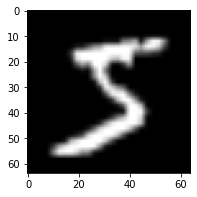

In [ ]:
def prepare_data():
  return torchvision.datasets.MNIST(root = 'data', train = True,
                                    download = True, transform = transforms.Compose([transforms.Resize(parameter['features_size']),
                                                                                     transforms.ToTensor(),
                                                                                     transforms.Normalize(mean=[0.5],
                                                                                                          std=[0.5])]))

def prepare_loader(dataset):
  train_loader = torch.utils.data.DataLoader(dataset, batch_size=parameter['batch_size'],
                                             num_workers = parameter['num_workers'])
  return train_loader

dataset = prepare_data()
train_loader = prepare_loader(dataset)

dataIter = iter(train_loader)
images, labels = dataIter.next()

img = np.squeeze(images[0])

fig = plt.figure(figsize = (3,3)) 
ax = fig.add_subplot(111)
ax.imshow(img, cmap='gray')

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

D = Discriminator().to(device)
G = Generator().to(device)
init_weights(D)
init_weights(G)

print(D)
print()
print(G)

d_optimizer = optim.Adam(D.parameters(), lr = parameter['lr'], betas = (0.5,0.999))
g_optimizer = optim.Adam(G.parameters(), lr = parameter['lr'], betas = (0.5, 0.999))

criterion = nn.BCELoss()

cuda
Discriminator(
  (model): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

Generator(
  (model): S

Epoch[0/10] Batch 0/469 Loss D: 1.3919 Loss G: 0.7053


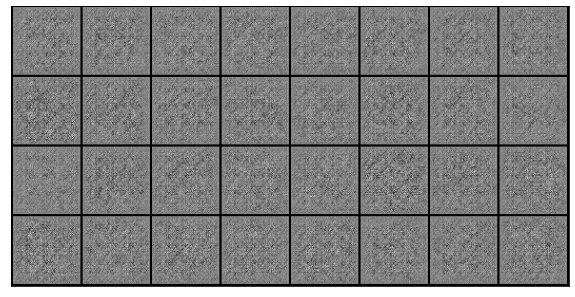

Epoch[0/10] Batch 100/469 Loss D: 0.0277 Loss G: 4.2330


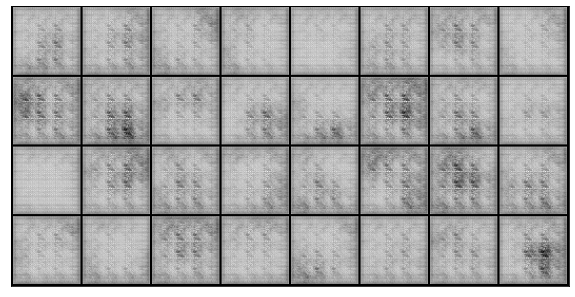

Epoch[0/10] Batch 200/469 Loss D: 0.0075 Loss G: 5.5079


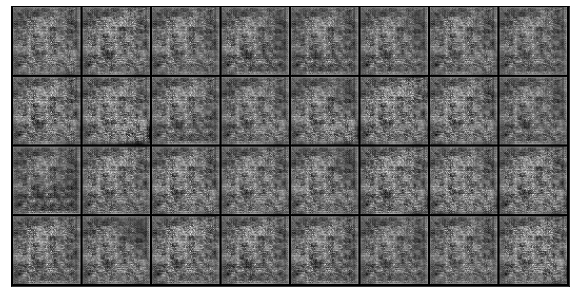

Epoch[0/10] Batch 300/469 Loss D: 0.0034 Loss G: 6.3198


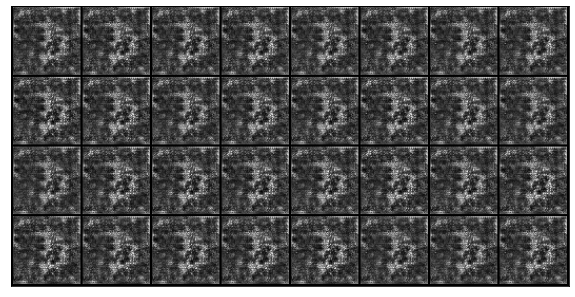

Epoch[0/10] Batch 400/469 Loss D: 0.7981 Loss G: 1.4253


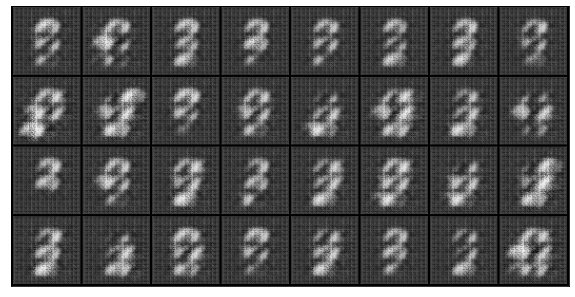

Epoch[1/10] Batch 0/469 Loss D: 1.2953 Loss G: 1.2898


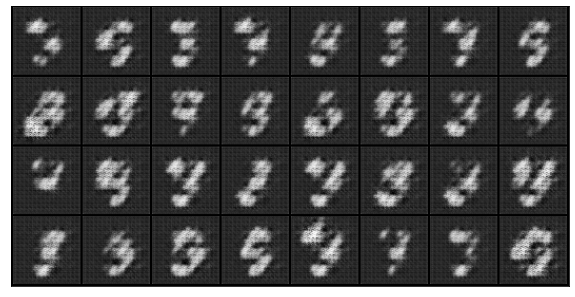

Epoch[1/10] Batch 100/469 Loss D: 1.2811 Loss G: 1.9719


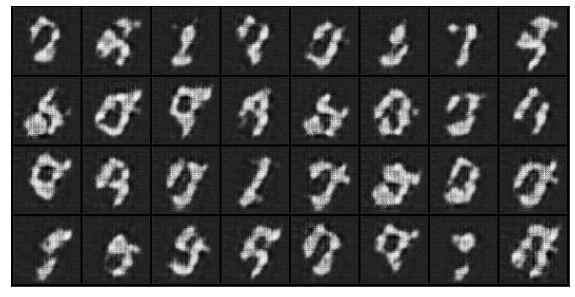

Epoch[1/10] Batch 200/469 Loss D: 0.6407 Loss G: 2.7093


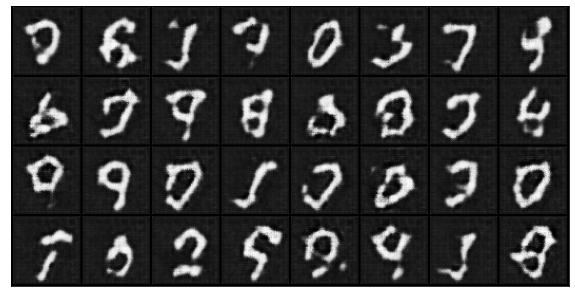

Epoch[1/10] Batch 300/469 Loss D: 0.6935 Loss G: 2.3635


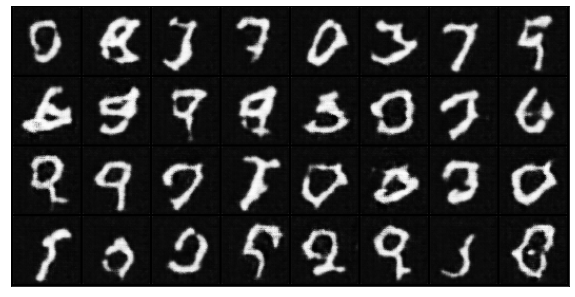

Epoch[1/10] Batch 400/469 Loss D: 0.7488 Loss G: 1.9919


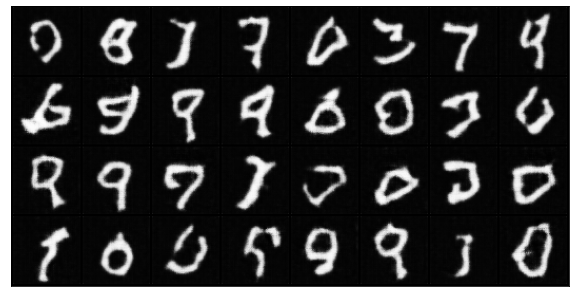

Epoch[2/10] Batch 0/469 Loss D: 1.0801 Loss G: 1.2169


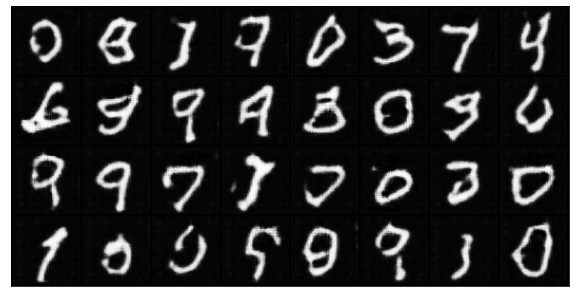

Epoch[2/10] Batch 100/469 Loss D: 0.8790 Loss G: 2.3582


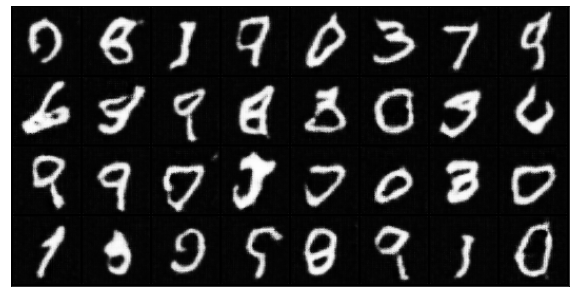

Epoch[2/10] Batch 200/469 Loss D: 1.4192 Loss G: 1.1971


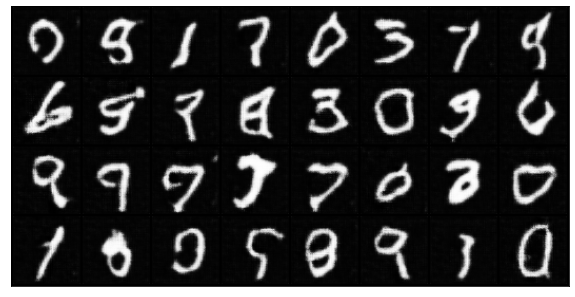

Epoch[2/10] Batch 300/469 Loss D: 0.6175 Loss G: 2.4973


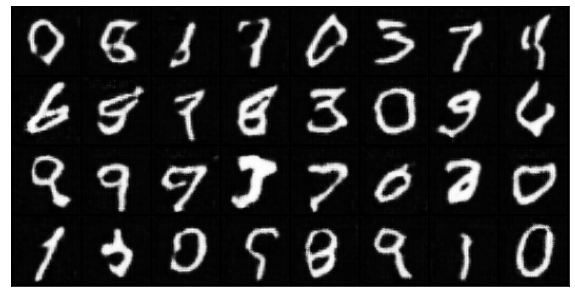

Epoch[2/10] Batch 400/469 Loss D: 0.7787 Loss G: 1.2847


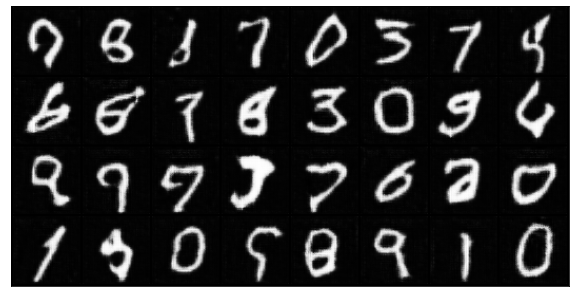

Epoch[3/10] Batch 0/469 Loss D: 0.9257 Loss G: 0.9251


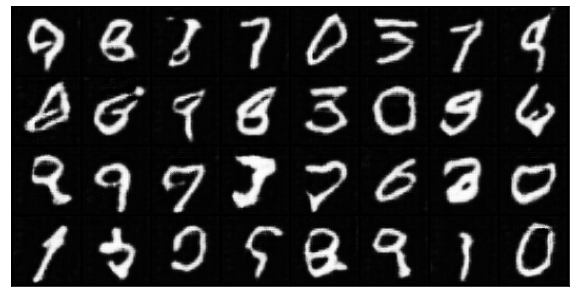

Epoch[3/10] Batch 100/469 Loss D: 0.8312 Loss G: 3.0056


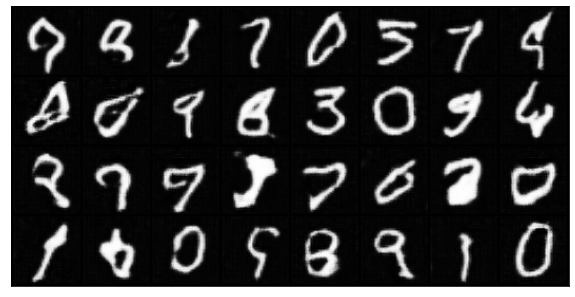

Epoch[3/10] Batch 200/469 Loss D: 0.4368 Loss G: 2.2160


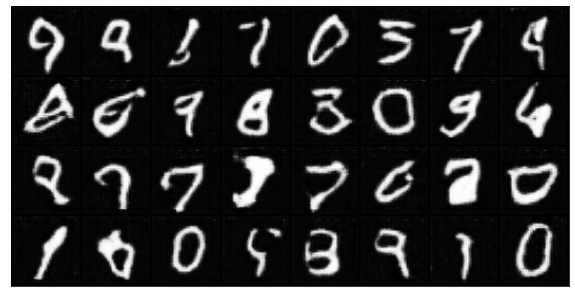

Epoch[3/10] Batch 300/469 Loss D: 1.0286 Loss G: 4.0354


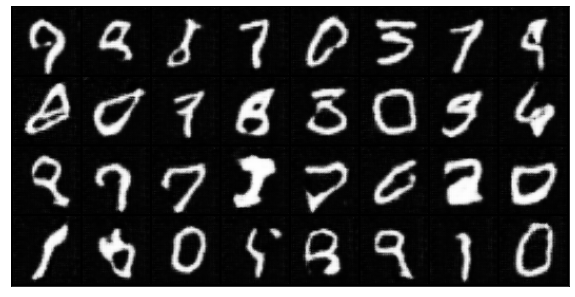

Epoch[3/10] Batch 400/469 Loss D: 0.5628 Loss G: 2.9035


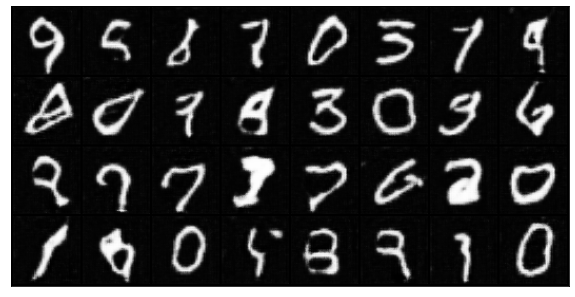

Epoch[4/10] Batch 0/469 Loss D: 0.5058 Loss G: 1.7174


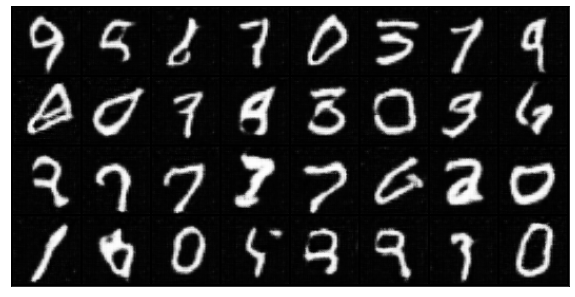

Epoch[4/10] Batch 100/469 Loss D: 0.7978 Loss G: 1.9127


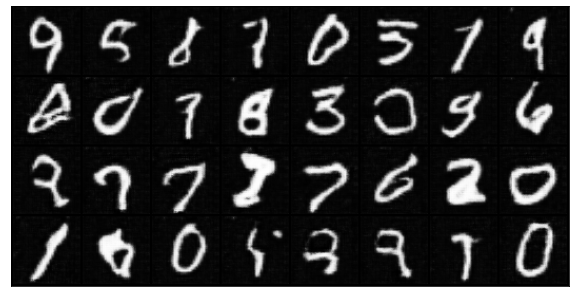

Epoch[4/10] Batch 200/469 Loss D: 0.3115 Loss G: 2.4521


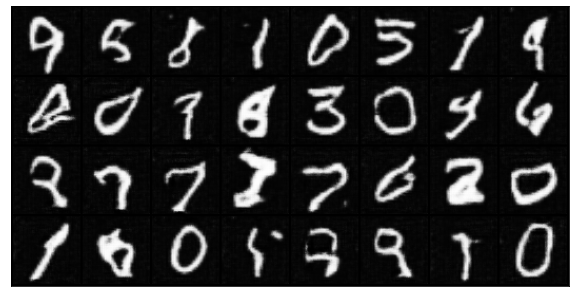

Epoch[4/10] Batch 300/469 Loss D: 0.5367 Loss G: 2.2673


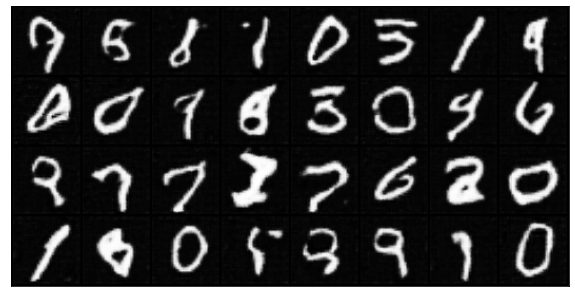

Epoch[4/10] Batch 400/469 Loss D: 0.5167 Loss G: 3.2740


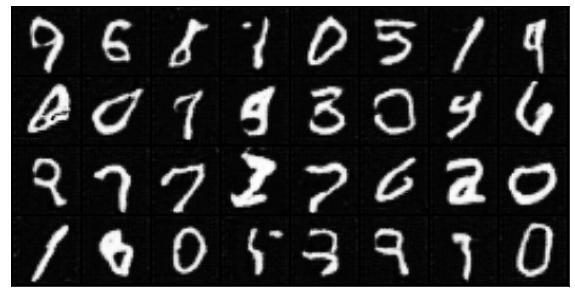

Epoch[5/10] Batch 0/469 Loss D: 0.8949 Loss G: 0.9276


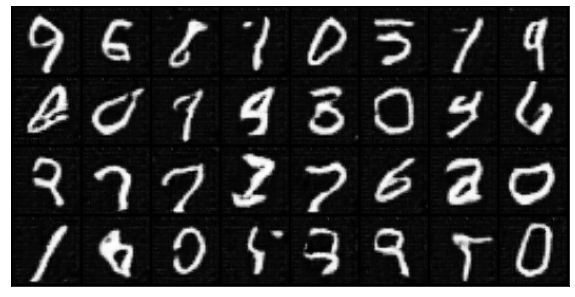

Epoch[5/10] Batch 100/469 Loss D: 0.8008 Loss G: 3.1338


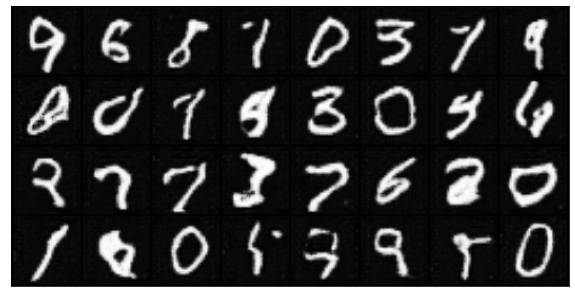

Epoch[5/10] Batch 200/469 Loss D: 0.3290 Loss G: 3.2672


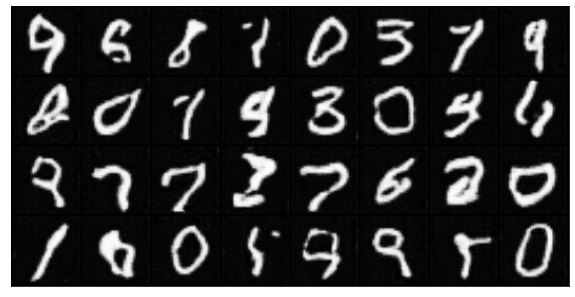

Epoch[5/10] Batch 300/469 Loss D: 0.4293 Loss G: 2.2690


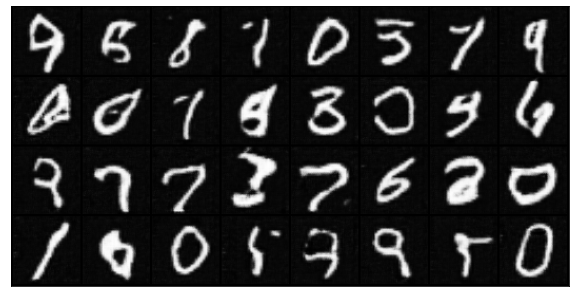

Epoch[5/10] Batch 400/469 Loss D: 1.0389 Loss G: 1.6863


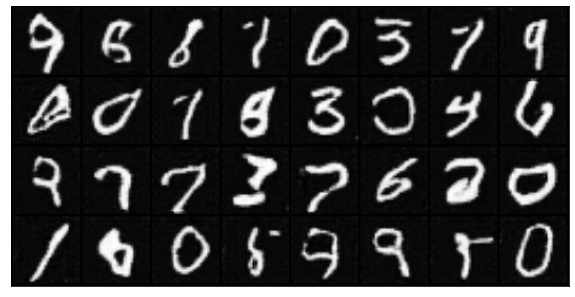

Epoch[6/10] Batch 0/469 Loss D: 0.8756 Loss G: 1.0448


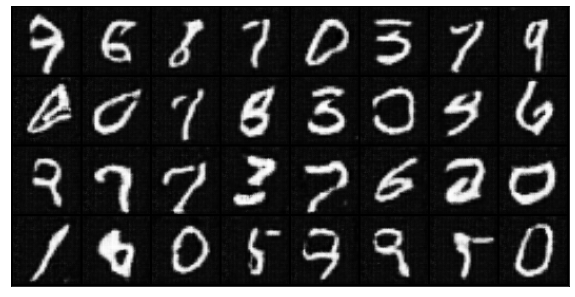

Epoch[6/10] Batch 100/469 Loss D: 0.6658 Loss G: 1.6829


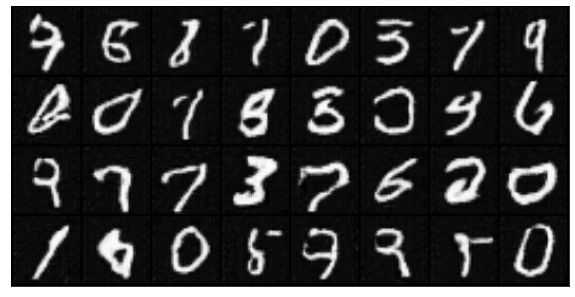

Epoch[6/10] Batch 200/469 Loss D: 0.6552 Loss G: 0.9723


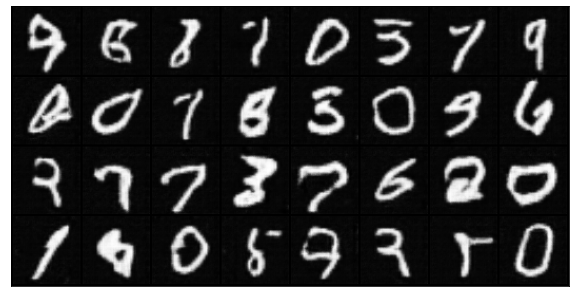

Epoch[6/10] Batch 300/469 Loss D: 0.7111 Loss G: 1.8129


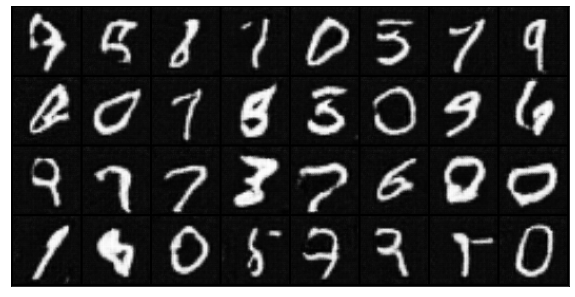

Epoch[6/10] Batch 400/469 Loss D: 1.2646 Loss G: 1.0243


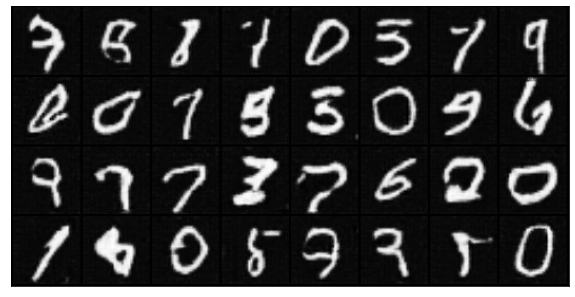

Epoch[7/10] Batch 0/469 Loss D: 0.6040 Loss G: 2.6992


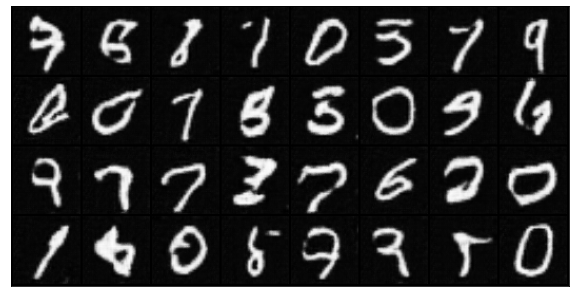

Epoch[7/10] Batch 100/469 Loss D: 0.7579 Loss G: 2.1319


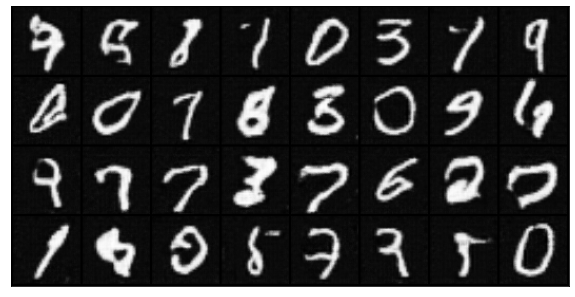

Epoch[7/10] Batch 200/469 Loss D: 0.6961 Loss G: 1.2257


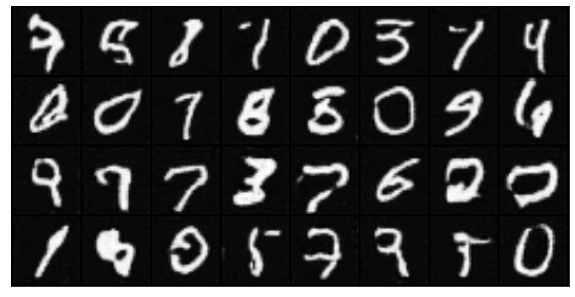

Epoch[7/10] Batch 300/469 Loss D: 0.5240 Loss G: 2.0396


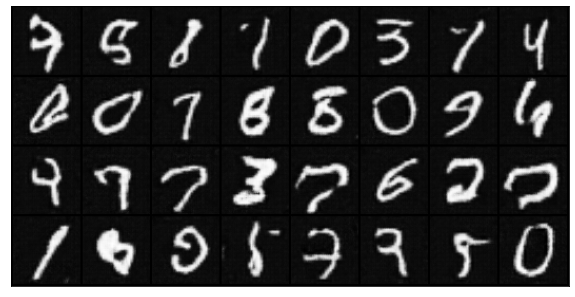

Epoch[7/10] Batch 400/469 Loss D: 0.3234 Loss G: 2.9599


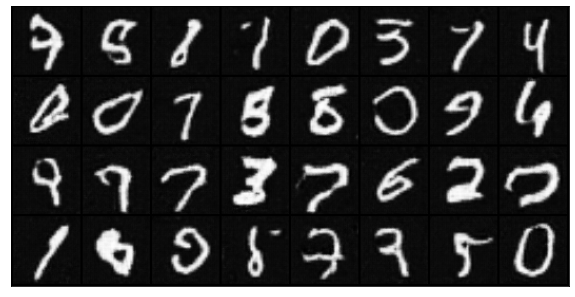

Epoch[8/10] Batch 0/469 Loss D: 0.9333 Loss G: 3.0239


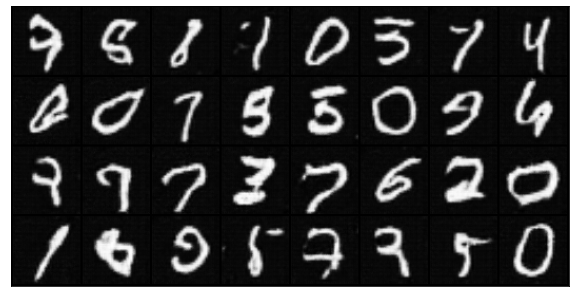

Epoch[8/10] Batch 100/469 Loss D: 0.5062 Loss G: 3.1340


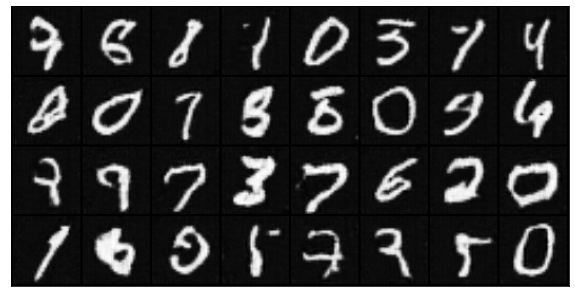

Epoch[8/10] Batch 200/469 Loss D: 0.6753 Loss G: 4.4533


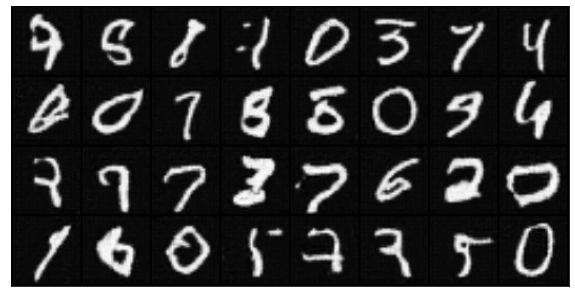

Epoch[8/10] Batch 300/469 Loss D: 0.3317 Loss G: 2.3304


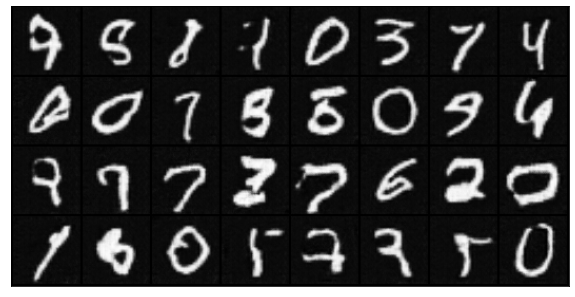

Epoch[8/10] Batch 400/469 Loss D: 0.4200 Loss G: 2.5035


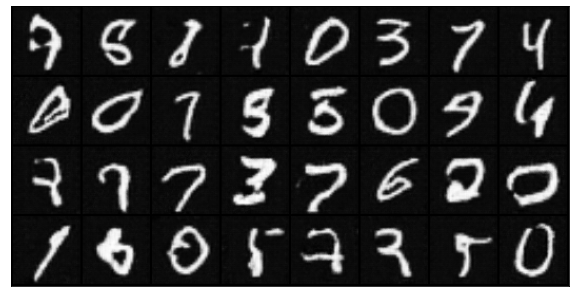

Epoch[9/10] Batch 0/469 Loss D: 0.7160 Loss G: 0.7838


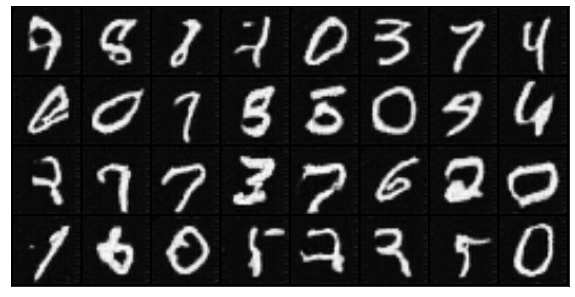

Epoch[9/10] Batch 100/469 Loss D: 1.5900 Loss G: 0.5494


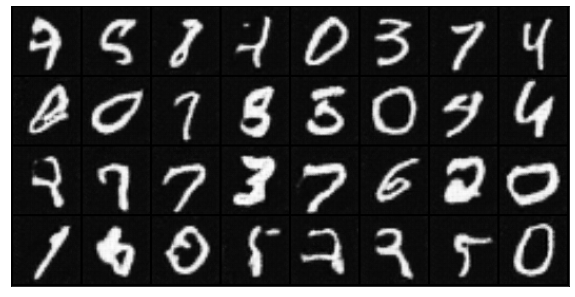

Epoch[9/10] Batch 200/469 Loss D: 0.3012 Loss G: 3.0385


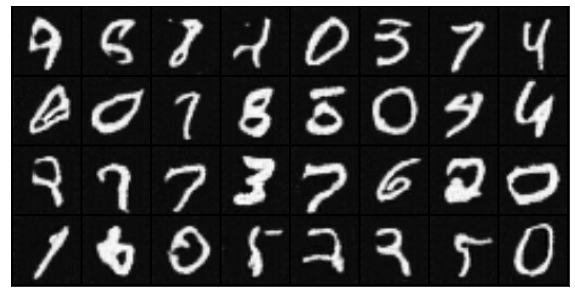

Epoch[9/10] Batch 300/469 Loss D: 0.4012 Loss G: 5.0045


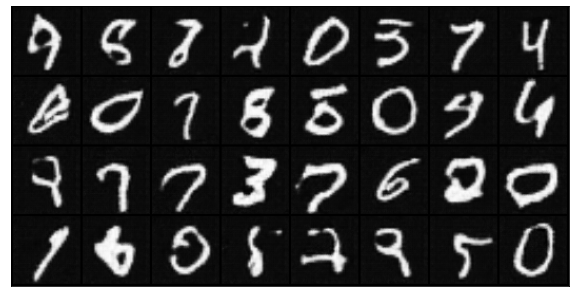

Epoch[9/10] Batch 400/469 Loss D: 0.5826 Loss G: 4.3923


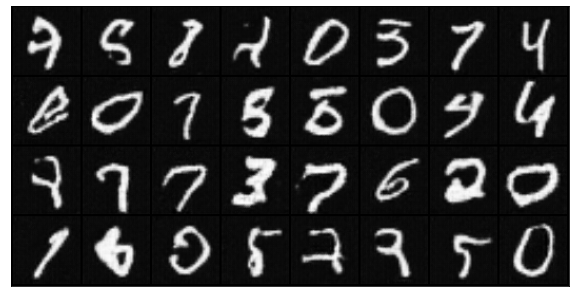

In [ ]:
fixed_z = torch.randn(parameter['batch_size'], parameter['z_size'],1,1).to(device)
img_list = []
G_losses = []
D_losses = []

for epoch in range (parameter['n_epochs']):
  for batch_i, (real_images,_) in enumerate(train_loader):
    real_images = real_images.to(device)

    # TRAIN DISCRIMINATOR
    D_real = D(real_images).view(-1)
    D_real_loss = criterion(D_real, torch.ones_like(D_real))

    z = torch.randn(parameter['batch_size'], parameter['z_size'],1,1).to(device)
    D_fake = D(G(z)).view(-1)
    D_fake_loss = criterion(D_fake, torch.zeros_like(D_fake))

    D_loss = D_real_loss+D_fake_loss
    d_optimizer.zero_grad()
    D_loss.backward()
    d_optimizer.step()

    #TRAIN GENERATOR

    z = torch.randn(parameter['batch_size'], parameter['z_size'],1,1).to(device)
    G_fake = D(G(z)).view(-1)
        
    G_loss = criterion(G_fake, torch.ones_like(G_fake))
        
    g_optimizer.zero_grad()
    G_loss.backward()
    g_optimizer.step()  

    G_losses.append(G_loss.item())
    D_losses.append(D_loss.item())

    if batch_i % 100 == 0 :
      print (f"Epoch[{epoch}/{parameter['n_epochs']}] Batch {batch_i}/{len(train_loader)} Loss D: {D_loss:.4f} Loss G: {G_loss:.4f}"
      )

      with torch.no_grad():
        fake  = G(fixed_z)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        npimgs = img_grid_fake.detach().cpu().numpy()
        plt.figure(figsize=(10,10))
        plt.imshow(np.transpose(npimgs, (1,2,0)), cmap='Greys_r')
        plt.xticks([])
        plt.yticks([])
        plt.show()
      img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))



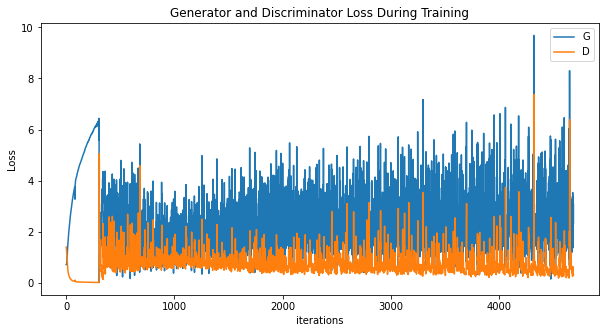

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

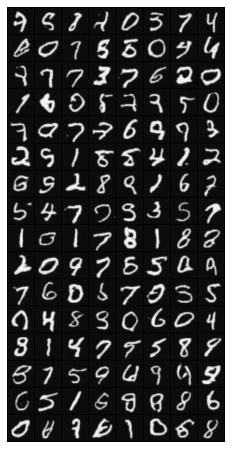

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.detach().cpu().numpy(),(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

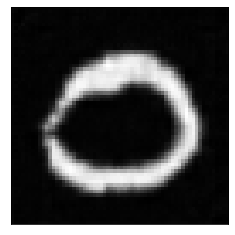

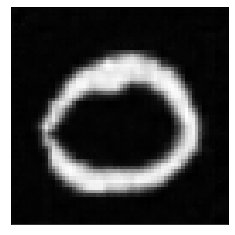

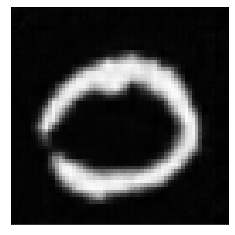

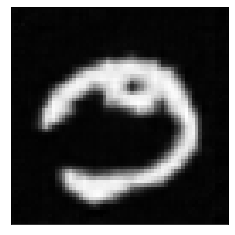

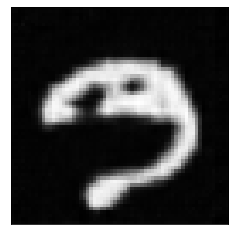

...

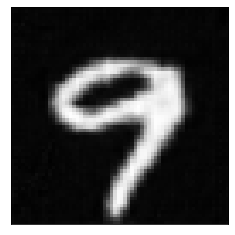

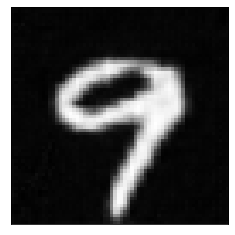

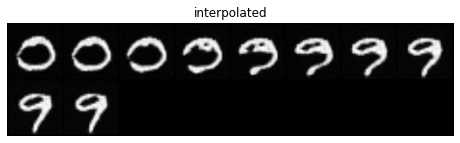

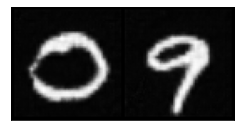

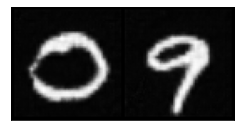

In [ ]:
noise_to_interpolate = torch.randn(2, 100,1,1, device=device)


list_images_ = []
def interpolate_points(p1,p2,n_step = 10):
  ratios = torch.linspace(0,1,steps = 10)
  
  for ratio in ratios:
    v = (1.0-ratio)*p1 + ratio*p2
    v = v.unsqueeze(0)
    fake = G(v).detach().cpu()
    list_images_.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))
    img_grid_fake = torchvision.utils.make_grid(fake[:1], normalize=True)
    npimgs = img_grid_fake.detach().cpu().numpy()
    plt.figure(figsize=(4,4))
    plt.imshow(np.transpose(npimgs, (1,2,0)), cmap='Greys_r')
    plt.xticks([])
    plt.yticks([])
    plt.show()

interpolated = interpolate_points(noise_to_interpolate[0],noise_to_interpolate[1])
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("interpolated")
plt.imshow(np.transpose(torchvision.utils.make_grid(list_images_[:64], padding=2, normalize=True).cpu(),(1,2,0)))
